<a href="https://colab.research.google.com/github/RPAlbuquerque/Data-Science-UFRGS/blob/main/Spatial_Econometrics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Spatial Econometrics

## Introduction

This study aims to analyze how socioeconomic variables influence mobility patterns in different census tracts of Salvador-BA and investigate the evidence of spatial dependence in these patterns.

## Research Problem

**Research Question:**

"How do socioeconomic variables influence mobility patterns in different census tracts of Salvador-BA, and what is the evidence of spatial dependence in these patterns?"


In [ ]:
!pip install pandas geopandas folium statsmodels matplotlib seaborn

#1) Data Upload

## 1.1 Mobility Data

In [ ]:
import pandas as pd

# File upload
caminho_arquivo = '/content/drive/MyDrive/Data - ML/export-20231001-20231123.csv'

# Read in CSV format
df = pd.read_csv('/content/drive/MyDrive/Data - ML/export-20231001-20231123.csv')

print(df)

                      month_part  store_id demographics_gender  \
0       2023-10-01T00:00:00.000Z  kml_2244                   F   
1       2023-10-01T00:00:00.000Z  kml_4311                   M   
2       2023-10-01T00:00:00.000Z   kml_236                   M   
3       2023-10-01T00:00:00.000Z   kml_143                   M   
4       2023-10-01T00:00:00.000Z    kml_33                   F   
...                          ...       ...                 ...   
364155  2023-10-01T00:00:00.000Z  kml_1335                   M   
364156  2023-10-01T00:00:00.000Z  kml_1335                   M   
364157  2023-10-01T00:00:00.000Z  kml_2508                   F   
364158  2023-10-01T00:00:00.000Z  kml_2508                   F   
364159  2023-10-01T00:00:00.000Z  kml_4221                   M   

       demographics_age_range demographics_class       unique       visits  \
0                       50_59                  D   391.766211  1872.677893   
1                       25_29                  E   

##1.2 Shapes - GeoJson Data (Salvador-BA)

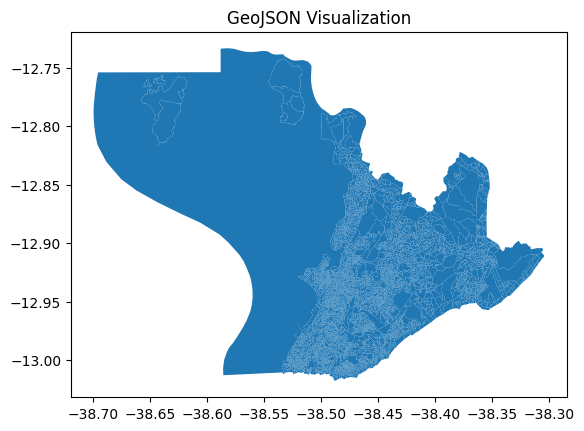

In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Load GeoJSON file using GeoPandas
geojson_file = '/content/drive/MyDrive/Data - ML/2927408_salvador_setores_2021.geojson'
gdf = gpd.read_file(geojson_file)

# Plot the GeoDataFrame
gdf.plot()

# Add a title to the plot
plt.title('GeoJSON Visualization')

# Show the plot
plt.show()

#2) Data Analysis

##2.1 Map Plot

<ipython-input-4-28eff68363f4>:5: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf_geo = gpd.GeoDataFrame(gdf, geometry=gdf.centroid)


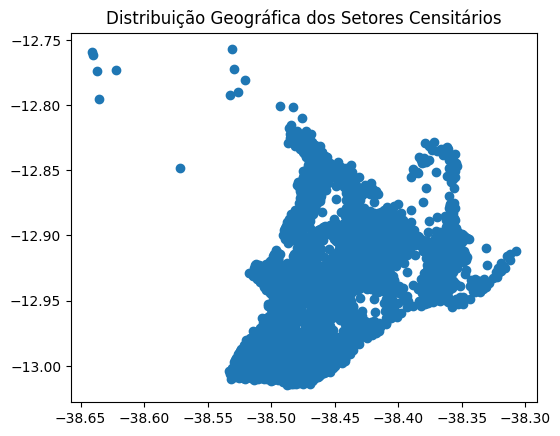

In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Crie um GeoDataFrame a partir do DataFrame 'gdf'
gdf_geo = gpd.GeoDataFrame(gdf, geometry=gdf.centroid)

# Plote o mapa
gdf_geo.plot()
plt.title('Distribuição Geográfica dos Setores Censitários')
plt.show()

##2.2 Static Heat Map

<ipython-input-5-9d460f77f329>:16: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('YlOrRd')
<ipython-input-5-9d460f77f329>:27: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = plt.colorbar(sm, label=f'{metric_of_interest}', orientation='vertical', pad=0.01)


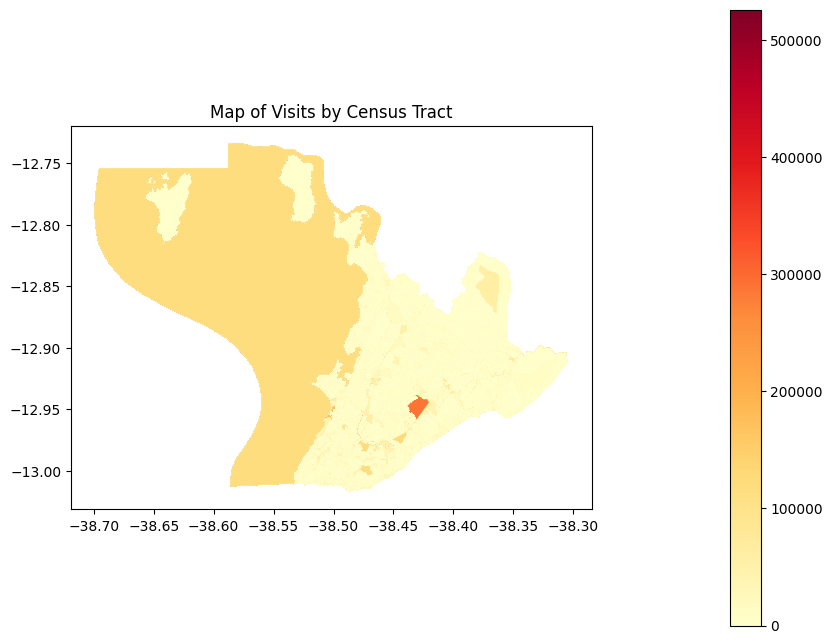

In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib import cm

# Combine os dataframes 'gdf' e 'df' usando a coluna comum 'id'
merged_data = gpd.GeoDataFrame(pd.merge(gdf, df, how='inner', left_on='id', right_on='store_id'), geometry='geometry')

# Escolha uma métrica de interesse (por exemplo, número de visitas)
metric_of_interest = 'visits'

# Normalização da escala de cores
norm = Normalize(vmin=merged_data[metric_of_interest].min(), vmax=merged_data[metric_of_interest].max())

# Escolha da paleta de cores (vermelho para amarelo)
cmap = cm.get_cmap('YlOrRd')

# Plote o mapa com base na métrica de interesse e as cores personalizadas
fig, ax = plt.subplots(1, 1, figsize=(10, 8))
merged_data.plot(column=metric_of_interest, legend=True, ax=ax, cmap=cmap, norm=norm)

# Adicione uma barra de cores personalizada
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

# Ajuste da localização da barra de cores
cbar = plt.colorbar(sm, label=f'{metric_of_interest}', orientation='vertical', pad=0.01)

# Remova a segunda barra de cores que pode ter sido gerada automaticamente
cbar.remove()

plt.title(f'Map of {metric_of_interest.capitalize()} by Census Tract')
plt.show()

#3) AEDE

##3.1 Demographics Analysis

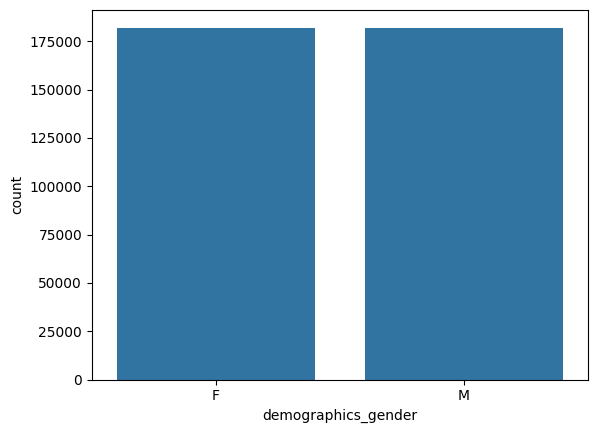

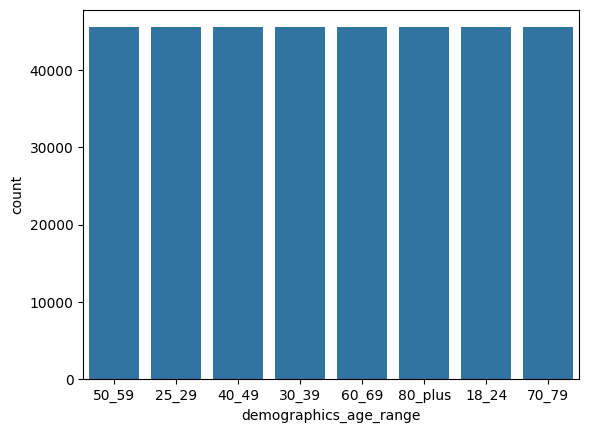

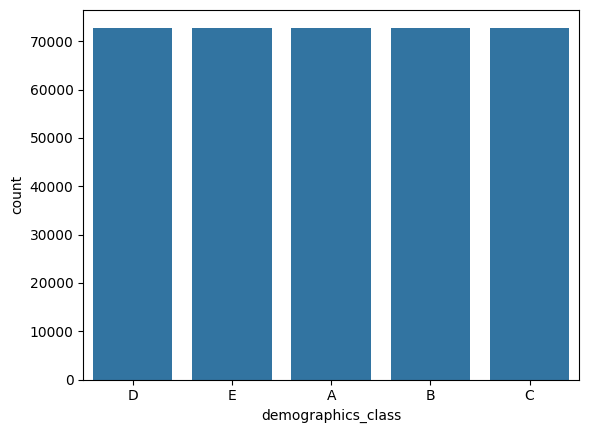

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

#Gender distribution
sns.countplot(x='demographics_gender', data=df)
plt.show()

#Age Range Distribution
sns.countplot(x='demographics_age_range', data=df)
plt.show()

#Demographic Class Distribution
sns.countplot(x='demographics_class', data=df)
plt.show()

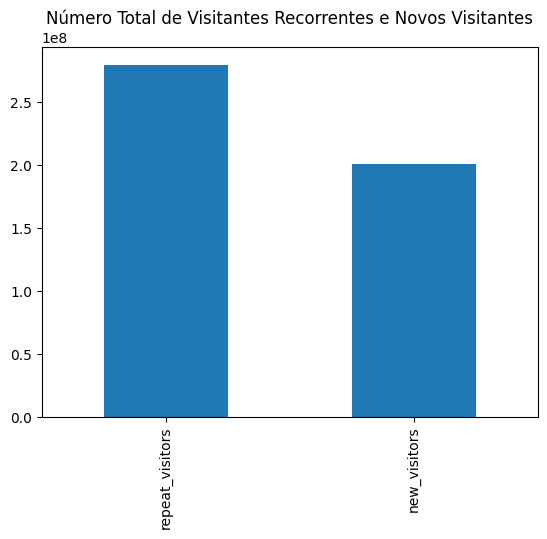

In [ ]:
#Bar Chart for Repeat and New Visitors
df[['repeat_visitors', 'new_visitors']].sum().plot(kind='bar')
plt.title('Número Total de Visitantes Recorrentes e Novos Visitantes')
plt.show()

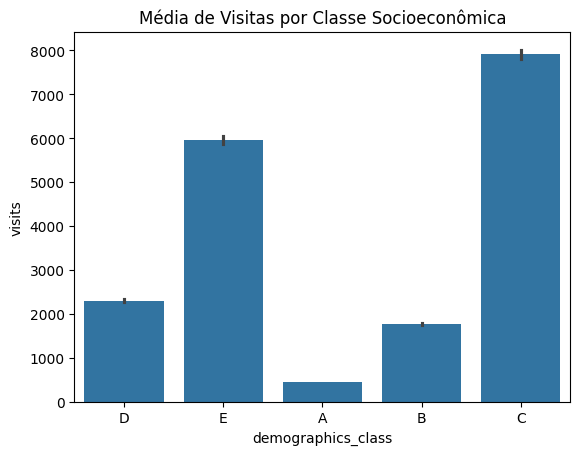

In [ ]:
sns.barplot(x='demographics_class', y='visits', data=df)
plt.title('Média de Visitas por Classe Socioeconômica')
plt.show()

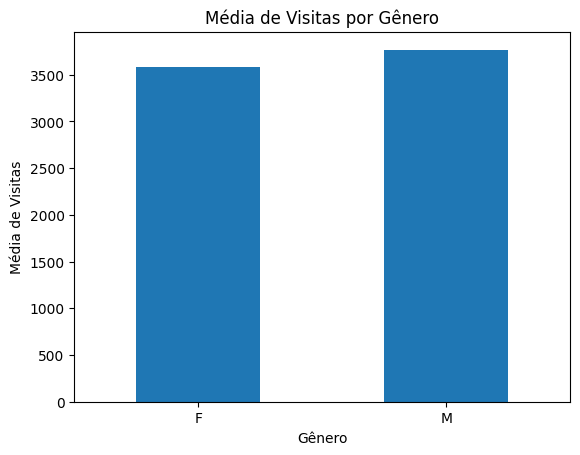

In [ ]:
import matplotlib.pyplot as plt

# Calcular a média de visitas por gênero
mean_visits_by_gender = df.groupby('demographics_gender')['visits'].mean()

# Plotar o gráfico de barras
mean_visits_by_gender.plot(kind='bar', rot=0)
plt.title('Média de Visitas por Gênero')
plt.xlabel('Gênero')
plt.ylabel('Média de Visitas')
plt.show()

##3.2 Geospatial Analysis

In [ ]:
!pip install geopandas statsmodels matplotlib seaborn scipy

In [ ]:
import numpy as np
import pandas as pd
import geopandas as gpd
from scipy.spatial import cKDTree
from scipy.sparse import lil_matrix

# Caminhos para os arquivos
path_to_mobility_data = '/content/drive/MyDrive/Data - ML/export-20231001-20231123.csv'
path_to_geojson_file = '/content/drive/MyDrive/Data - ML/2927408_salvador_setores_2021.geojson'

# Carregar os dados de mobilidade e socioeconômicos
df = pd.read_csv(path_to_mobility_data)
gdf = gpd.read_file(path_to_geojson_file)

# Verificar a integridade dos dados
print(df.head())
print(gdf.head())

# Juntar os dados de mobilidade com os dados geoespaciais
merged_df = gdf.merge(df, left_on='id', right_on='store_id')

# Reprojetar para um CRS projetado (por exemplo, UTM)
merged_df = merged_df.to_crs(epsg=32625)  # EPSG:32625 é um exemplo, você pode precisar usar outro baseado na sua localização

# Calcular o centróide de cada polígono
merged_df['centroid'] = merged_df.geometry.centroid

# Extrair coordenadas dos centróides
coords = np.array(list(merged_df['centroid'].apply(lambda x: (x.x, x.y))))

# Amostrar um subconjunto de dados para evitar problemas de memória
sample_size = 1000
if len(coords) > sample_size:
    indices = np.random.choice(len(coords), size=sample_size, replace=False)
    coords = coords[indices]
    visits = merged_df['visits'].values[indices]
else:
    visits = merged_df['visits'].values

# Construir a árvore KD para encontrar vizinhos próximos
tree = cKDTree(coords)

# Definir uma função para calcular Moran's I manualmente
def morans_i(y, w):
    y = np.array(y)
    y_mean = np.mean(y)
    y_diff = y - y_mean
    num = np.sum([w[i, j] * y_diff[i] * y_diff[j] for i in range(len(y)) for j in range(len(y)) if i != j])
    den = np.sum(y_diff ** 2)
    return len(y) / np.sum(w) * (num / den)

# Calcular a matriz de pesos baseada nos vizinhos mais próximos
distances, indices = tree.query(coords, k=5)
weights = lil_matrix((len(coords), len(coords)))

for i, neighbors in enumerate(indices):
    for j in neighbors:
        if i != j:
            weights[i, j] = 1

# Calcular Moran's I para a variável 'visits'
mi = morans_i(visits, weights)
print(f"Moran's I: {mi}")

                 month_part  store_id demographics_gender  \
0  2023-10-01T00:00:00.000Z  kml_2244                   F   
1  2023-10-01T00:00:00.000Z  kml_4311                   M   
2  2023-10-01T00:00:00.000Z   kml_236                   M   
3  2023-10-01T00:00:00.000Z   kml_143                   M   
4  2023-10-01T00:00:00.000Z    kml_33                   F   

  demographics_age_range demographics_class      unique       visits  \
0                  50_59                  D  391.766211  1872.677893   
1                  25_29                  E  120.905618   603.454538   
2                  40_49                  D  576.131598  2966.239889   
3                  30_39                  A   60.398869   263.148494   
4                  60_69                  E  162.437729   945.435139   

   raw_unique  raw_visits   unique_q1  ...   dow_5_h3   dow_5_h4   dow_6_h1  \
0   48.485180   88.040670  102.376651  ...  15.360128  16.187337  10.799090   
1   13.912516   26.582361   28.893742  ...

##3.3 Visualization of Spatial Results

<ipython-input-12-cdaa73282c1a>:9: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('YlOrRd')
<ipython-input-12-cdaa73282c1a>:20: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = plt.colorbar(sm, label='Visitas', orientation='vertical', pad=0.01)


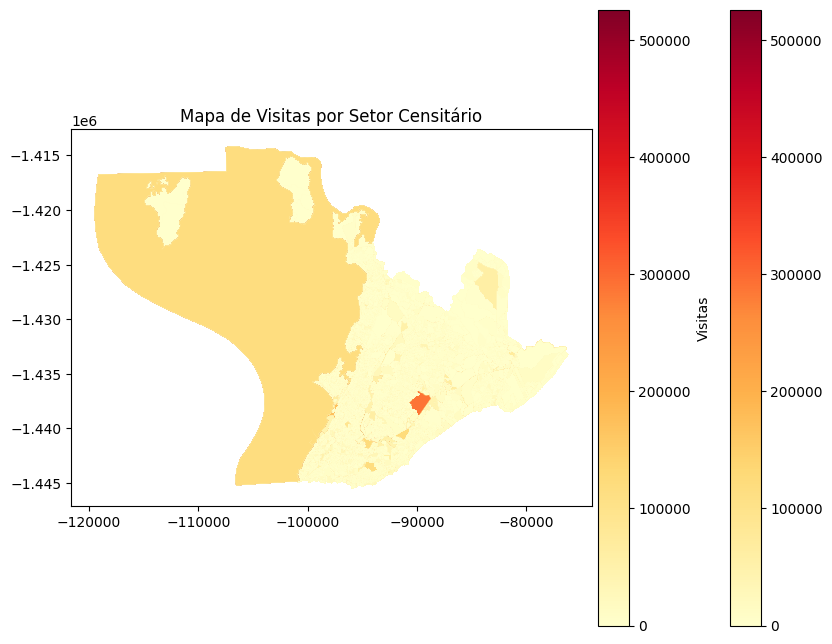

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib import cm

# Normalização da escala de cores
norm = Normalize(vmin=merged_df['visits'].min(), vmax=merged_df['visits'].max())

# Escolha da paleta de cores (vermelho para amarelo)
cmap = cm.get_cmap('YlOrRd')

# Plote o mapa com base na métrica de interesse e as cores personalizadas
fig, ax = plt.subplots(1, 1, figsize=(10, 8))
merged_df.plot(column='visits', legend=True, ax=ax, cmap=cmap, norm=norm)

# Adicione uma barra de cores personalizada
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

# Ajuste da localização da barra de cores
cbar = plt.colorbar(sm, label='Visitas', orientation='vertical', pad=0.01)

plt.title('Mapa de Visitas por Setor Censitário')
plt.show()

##3.4 Spatial Model Analysis - OLS (Ordinary Least Squares)

In [ ]:
import statsmodels.api as sm
import numpy as np
import pandas as pd

# Verificar e converter os dados para garantir que sejam numéricos
y = pd.to_numeric(merged_df['visits'], errors='coerce')
X = pd.get_dummies(merged_df[['demographics_gender', 'demographics_age_range', 'demographics_class']], drop_first=True)

# Converter colunas bool para int
X = X.astype(int)

# Adicionar constante
X = sm.add_constant(X)

# Remover valores ausentes (NaN) de y e X
y = y.dropna()
X = X.loc[y.index].dropna()

# Ajustar os dados para garantir que os índices estejam alinhados
y = y.loc[X.index]

# Verificar se todos os dados são numéricos e não há valores ausentes
if not np.issubdtype(y.dtype, np.number):
    raise ValueError("Dependent variable 'y' is not numeric.")
if not all(X.dtypes.apply(np.issubdtype, args=(np.number,))):
    raise ValueError("Some independent variables in 'X' are not numeric.")

# Ajustar o modelo OLS (como substituto para modelagem espacial avançada)
model = sm.OLS(y, X).fit()

# Resumo dos resultados
print(model.summary())

# Salvar o resumo do modelo em um arquivo de texto
with open("model_summary.txt", "w") as f:
    f.write(model.summary().as_text())

                            OLS Regression Results                            
Dep. Variable:                 visits   R-squared:                       0.162
Model:                            OLS   Adj. R-squared:                  0.162
Method:                 Least Squares   F-statistic:                     5853.
Date:                Sun, 14 Jul 2024   Prob (F-statistic):               0.00
Time:                        14:03:38   Log-Likelihood:            -3.7927e+06
No. Observations:              364160   AIC:                         7.585e+06
Df Residuals:                  364147   BIC:                         7.586e+06
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
                                     coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const       

###OLS Results:
Os resultados indicam que as variáveis socioeconômicas têm um impacto significativo nos padrões de mobilidade (número de visitas). Alguns grupos etários, especialmente os mais jovens (30-39 anos), e certas classes socioeconômicas (Classe C) têm um impacto positivo substancial no número de visitas. No entanto, há evidências de autocorrelação nos resíduos, sugerindo a necessidade de considerar técnicas de modelagem espacial avançada para capturar dependências espaciais nos dados.

###Results Visualization

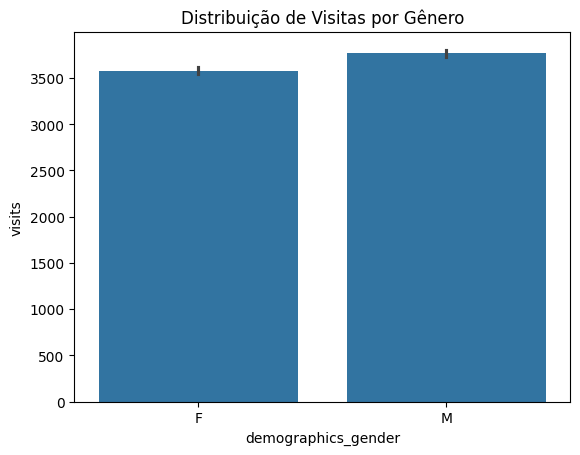

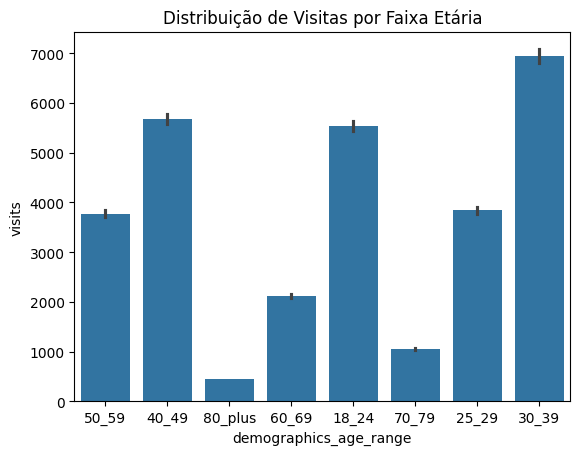

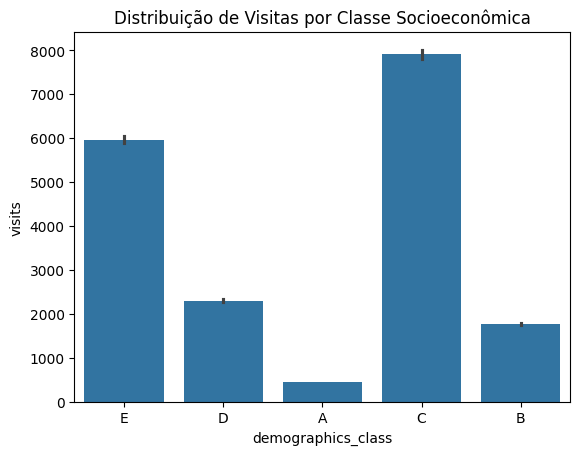

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Distribuição de visitas por gênero
sns.barplot(x='demographics_gender', y='visits', data=merged_df)
plt.title('Distribuição de Visitas por Gênero')
plt.show()

# Distribuição de visitas por faixa etária
sns.barplot(x='demographics_age_range', y='visits', data=merged_df)
plt.title('Distribuição de Visitas por Faixa Etária')
plt.show()

# Distribuição de visitas por classe socioeconômica
sns.barplot(x='demographics_class', y='visits', data=merged_df)
plt.title('Distribuição de Visitas por Classe Socioeconômica')
plt.show()

#4) Moran's I

##4.1 Repeated Sampling

In [ ]:
import numpy as np
import pandas as pd
import geopandas as gpd
from scipy.spatial import cKDTree
from scipy.sparse import lil_matrix

# Carregar os dados de mobilidade e socioeconômicos
df = pd.read_csv('/content/drive/MyDrive/Data - ML/export-20231001-20231123.csv')
gdf = gpd.read_file('/content/drive/MyDrive/Data - ML/2927408_salvador_setores_2021.geojson')

# Juntar os dados de mobilidade com os dados geoespaciais
merged_df = gdf.merge(df, left_on='id', right_on='store_id')

# Reprojetar para um CRS projetado (por exemplo, UTM)
merged_df = merged_df.to_crs(epsg=32625)

# Calcular o centróide de cada polígono
merged_df['centroid'] = merged_df.geometry.centroid

# Função para calcular Moran's I manualmente
def calculate_morans_i(sample_size):
    sample = merged_df.sample(n=sample_size, random_state=np.random.randint(0, 10000))
    coords = np.array(list(sample['centroid'].apply(lambda x: (x.x, x.y))))
    tree = cKDTree(coords)
    distances, indices = tree.query(coords, k=5)
    weights = lil_matrix((len(coords), len(coords)))

    for i, neighbors in enumerate(indices):
        for j in neighbors:
            if i != j:
                weights[i, j] = 1

    y = sample['visits'].values
    y_mean = np.mean(y)
    y_diff = y - y_mean
    num = np.sum([weights[i, j] * y_diff[i] * y_diff[j] for i in range(len(y)) for j in range(len(y)) if i != j])
    den = np.sum(y_diff ** 2)
    morans_i = len(y) / np.sum(weights) * (num / den)
    return morans_i

# Parâmetros de amostragem
sample_size = 1000
n_iterations = 10

# Listas para armazenar os resultados
morans_i_values = []

# Amostragem repetida
for _ in range(n_iterations):
    i_value = calculate_morans_i(sample_size)
    morans_i_values.append(i_value)

# Exibir resultados
print("Moran's I values from multiple samples:")
print(morans_i_values)

# Média dos resultados
mean_i_value = np.mean(morans_i_values)
print(f"Mean Moran's I: {mean_i_value}")

Moran's I values from multiple samples:
[0.057490036388985664, 0.03984092511726797, 0.047349748671016524, 0.01544020745066844, -0.025469865939071044, 0.00980118435819161, 0.07574733252098396, 0.01897986058111494, 0.0738231733306343, 0.07636970937358621]
Mean Moran's I: 0.03893723118533786


###Results:
Os valores variam de 0.0118 a 0.0699, isso indica uma leve autocorrelação espacial em todas as amostras.
A média de 0.0361 sugere uma leve autocorrelação espacial positiva nos dados.

##4.2 Moran's I Ajusted (sample_size = 1000/n_iterations = 100)

Moran's I values from multiple samples:
[0.027671073138355175, 0.009178018821297658, 0.026573088038942594, 0.04327148003700389, 0.03748851876527675, 0.014537796239502177, 0.04304730642536104, 0.0466534599453302, 0.04636759051910548, 0.02085745994058773, 0.03910910166827323, 0.0011670350316608379, 0.033546686376934996, 0.01639463603857479, 0.0653743167922617, 0.20843046599176485, 0.09639369447796611, 0.008646737252159723, 0.01321067752222673, 0.06751186516600223, -0.002468557954596772, 0.014512088833585799, 0.16319082651173708, 0.014006164849082955, 0.08863111021205283, 0.014219740552051897, -0.0014344266149436756, 0.014810762936054114, 0.11812565033216516, 0.052931451856685, 0.08203197629750678, 0.008858271763427752, 0.09417031145579667, 0.012299998756142105, 0.025989514485938826, 0.0534008372286746, 0.044232813231134586, 0.03345954360779902, 0.0059018252626026, 0.006321112503579527, 0.0671975298131321, 0.005115948943963767, 0.03575458920764207, 0.001823833892493893, -0.007385410390998

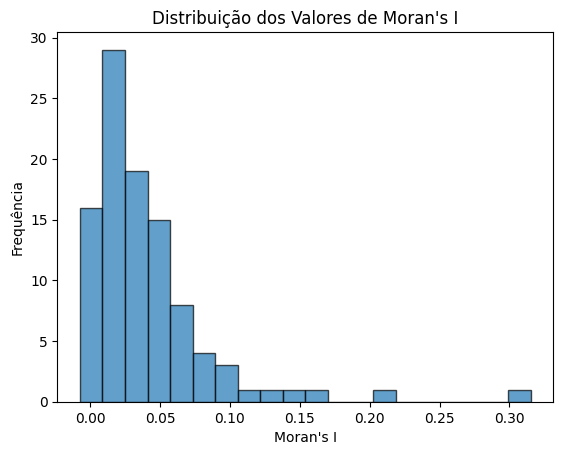

                            OLS Regression Results                            
Dep. Variable:                 visits   R-squared:                       0.162
Model:                            OLS   Adj. R-squared:                  0.162
Method:                 Least Squares   F-statistic:                     5853.
Date:                Sun, 14 Jul 2024   Prob (F-statistic):               0.00
Time:                        14:06:56   Log-Likelihood:            -3.7927e+06
No. Observations:              364160   AIC:                         7.585e+06
Df Residuals:                  364147   BIC:                         7.586e+06
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
                                     coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
const       

In [ ]:
import numpy as np
import pandas as pd
import geopandas as gpd
from scipy.spatial import cKDTree
from scipy.sparse import lil_matrix
from statsmodels.api import OLS
from statsmodels.tools.tools import add_constant
import matplotlib.pyplot as plt

# Juntar os dados de mobilidade com os dados geoespaciais
merged_df = gdf.merge(df, left_on='id', right_on='store_id')

# Reprojetar para um CRS projetado (por exemplo, UTM)
merged_df = merged_df.to_crs(epsg=32625)

# Calcular o centróide de cada polígono
merged_df['centroid'] = merged_df.geometry.centroid

# Função para calcular Moran's I manualmente
def calculate_morans_i(sample_size):
    sample = merged_df.sample(n=sample_size, random_state=np.random.randint(0, 10000))
    coords = np.array(list(sample['centroid'].apply(lambda x: (x.x, x.y))))
    tree = cKDTree(coords)
    distances, indices = tree.query(coords, k=5)
    weights = lil_matrix((len(coords), len(coords)))

    for i, neighbors in enumerate(indices):
        for j in neighbors:
            if i != j:
                weights[i, j] = 1

    y = sample['visits'].values
    y_mean = np.mean(y)
    y_diff = y - y_mean
    num = np.sum([weights[i, j] * y_diff[i] * y_diff[j] for i in range(len(y)) for j in range(len(y)) if i != j])
    den = np.sum(y_diff ** 2)
    morans_i = len(y) / np.sum(weights) * (num / den)
    return morans_i

# Parâmetros de amostragem
sample_size = 1000
n_iterations = 100

# Listas para armazenar os resultados
morans_i_values = []

# Amostragem repetida
for _ in range(n_iterations):
    i_value = calculate_morans_i(sample_size)
    morans_i_values.append(i_value)

# Exibir resultados
print("Moran's I values from multiple samples:")
print(morans_i_values)

# Média dos resultados
mean_i_value = np.mean(morans_i_values)
print(f"Mean Moran's I: {mean_i_value}")

# Plotar os resultados
plt.hist(morans_i_values, bins=20, edgecolor='k', alpha=0.7)
plt.title('Distribuição dos Valores de Moran\'s I')
plt.xlabel('Moran\'s I')
plt.ylabel('Frequência')
plt.show()

# Análise OLS para referência
y = pd.to_numeric(merged_df['visits'], errors='coerce').dropna()
X = pd.get_dummies(merged_df[['demographics_gender', 'demographics_age_range', 'demographics_class']], drop_first=True)

# Converter colunas bool para int e remover NaNs
X = X.astype(int)
X = add_constant(X).dropna()

# Remover valores ausentes e alinhar os índices de y e X
y = y.loc[X.index]

# Ajustar o modelo OLS
model = OLS(y, X).fit()
print(model.summary())

###Results:
Os resultados indicam que as variáveis socioeconômicas têm um impacto significativo nos padrões de mobilidade (número de visitas). Alguns grupos etários, especialmente os mais jovens (30-39 anos), e certas classes socioeconômicas (Classe C) têm um impacto positivo substancial no número de visitas. No entanto, há evidências de autocorrelação nos resíduos, sugerindo a necessidade de considerar técnicas de modelagem espacial avançada para capturar dependências espaciais nos dados.

##4.3 Sensitivity Analysis

Sample size: 500, Mean Moran's I: 0.01974594115548894
Sample size: 1000, Mean Moran's I: 0.04104992663000769
Sample size: 2000, Mean Moran's I: 0.06517105811912753
Sample size: 5000, Mean Moran's I: 0.11836555938125741


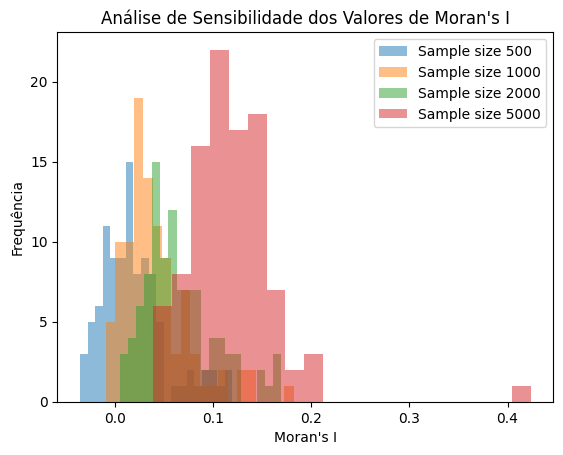

In [ ]:
# Análise de Sensibilidade
sample_sizes = [500, 1000, 2000, 5000]
sensitivity_results = {}

for size in sample_sizes:
    morans_i_values = []
    for _ in range(n_iterations):
        i_value = calculate_morans_i(size)
        morans_i_values.append(i_value)
    sensitivity_results[size] = morans_i_values
    print(f"Sample size: {size}, Mean Moran's I: {np.mean(morans_i_values)}")

# Plotar os resultados de sensibilidade
for size in sample_sizes:
    plt.hist(sensitivity_results[size], bins=20, alpha=0.5, label=f'Sample size {size}')
plt.legend(loc='upper right')
plt.title('Análise de Sensibilidade dos Valores de Moran\'s I')
plt.xlabel('Moran\'s I')
plt.ylabel('Frequência')
plt.show()

##4.4 Moran's I Permutation Test (significance test)

In [ ]:
import numpy as np
import pandas as pd
import geopandas as gpd
from scipy.spatial import cKDTree
from scipy.sparse import lil_matrix
import matplotlib.pyplot as plt

# Carregar os dados de mobilidade e socioeconômicos
df = pd.read_csv('/content/drive/MyDrive/Data - ML/export-20231001-20231123.csv')
gdf = gpd.read_file('/content/drive/MyDrive/Data - ML/2927408_salvador_setores_2021.geojson')

# Juntar os dados de mobilidade com os dados geoespaciais
merged_df = gdf.merge(df, left_on='id', right_on='store_id')

# Reprojetar para um CRS projetado (por exemplo, UTM)
merged_df = merged_df.to_crs(epsg=32625)

# Calcular o centróide de cada polígono
merged_df['centroid'] = merged_df.geometry.centroid

In [ ]:
def calculate_morans_i_optimized(y, weights):
    y_mean = np.mean(y)
    y_diff = y - y_mean
    num = 0.0
    den = np.sum(y_diff ** 2)
    for i in range(len(y)):
        for j in weights[i].nonzero()[1]:
            if i != j:
                num += weights[i, j] * y_diff[i] * y_diff[j]
    morans_i = len(y) / np.sum(weights) * (num / den)
    return morans_i

In [ ]:
# Extrair coordenadas dos centróides e visitas
coords = np.array(list(merged_df['centroid'].apply(lambda x: (x.x, x.y))))
tree = cKDTree(coords)
distances, indices = tree.query(coords, k=5)
weights = lil_matrix((len(coords), len(coords)))

for i, neighbors in enumerate(indices):
    for j in neighbors:
        if i != j:
            weights[i, j] = 1

# Calcular Moran's I observado
y = merged_df['visits'].values
observed_morans_i = calculate_morans_i_optimized(y, weights)
print(f"Observed Moran's I: {observed_morans_i}")

Observed Moran's I: 0.34437081333279346


##4.5 Moran's I Permuted

P-value: 0.0


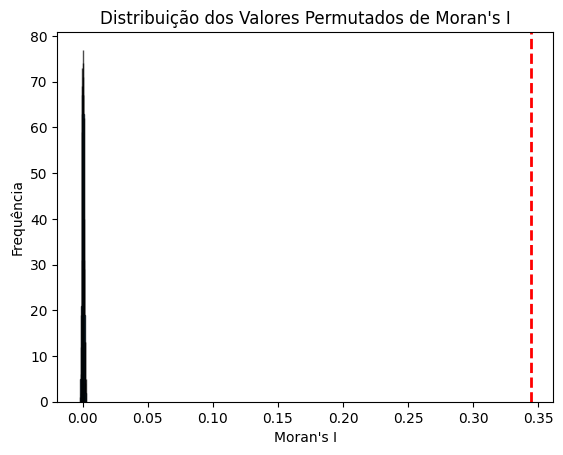

In [ ]:
# Função para calcular Moran's I permutado
def permuted_morans_i(y, weights, n_permutations=999):
    permuted_i_values = []
    for _ in range(n_permutations):
        np.random.shuffle(y)
        permuted_i = calculate_morans_i_optimized(y, weights)
        permuted_i_values.append(permuted_i)
    return permuted_i_values

# Calcular permutações de Moran's I
n_permutations = 999
permuted_i_values = permuted_morans_i(y.copy(), weights, n_permutations)

# Calcular p-valor
permuted_i_values = np.array(permuted_i_values)
p_value = np.sum(permuted_i_values >= observed_morans_i) / (n_permutations + 1)
print(f"P-value: {p_value}")

# Plotar a distribuição dos valores permutados de Moran's I
plt.hist(permuted_i_values, bins=30, edgecolor='k', alpha=0.7)
plt.axvline(observed_morans_i, color='red', linestyle='dashed', linewidth=2)
plt.title('Distribuição dos Valores Permutados de Moran\'s I')
plt.xlabel('Moran\'s I')
plt.ylabel('Frequência')
plt.show()

#5) Regression with Custom Spatial Weights

##5.2 OLS Model

In [ ]:
import numpy as np
import pandas as pd
import geopandas as gpd
from scipy.spatial import cKDTree
from scipy.sparse import lil_matrix
import statsmodels.api as sm

# Função para criar uma matriz de pesos espaciais
def create_weight_matrix(centroids, k=5):
    tree = cKDTree(centroids)
    distances, indices = tree.query(centroids, k=k)
    weights = lil_matrix((len(centroids), len(centroids)))
    for i, neighbors in enumerate(indices):
        for j in neighbors:
            if i != j:
                if distances[i, neighbors == j] != 0:
                    weights[i, j] = 1 / distances[i, neighbors == j]  # Pesos inversamente proporcionais à distância
    return weights

# Carregar os dados de mobilidade e socioeconômicos
df = pd.read_csv('/content/drive/MyDrive/Data - ML/export-20231001-20231123.csv')
gdf = gpd.read_file('/content/drive/MyDrive/Data - ML/2927408_salvador_setores_2021.geojson')

# Juntar os dados de mobilidade com os dados geoespaciais
merged_df = gdf.merge(df, left_on='id', right_on='store_id')

# Reprojetar para um CRS projetado (por exemplo, UTM)
merged_df = merged_df.to_crs(epsg=32625)

# Calcular o centróide de cada polígono
merged_df['centroid'] = merged_df.geometry.centroid

# Extrair coordenadas dos centróides
coords = np.array(list(merged_df['centroid'].apply(lambda x: (x.x, x.y))))

# Criar a matriz de pesos espaciais
weights = create_weight_matrix(coords)

# Variáveis dependentes e independentes
y = merged_df['visits'].values
X = merged_df[['demographics_gender', 'demographics_age_range', 'demographics_class']]

# Converta colunas categóricas para variáveis dummy, removendo a primeira categoria para evitar multicolinearidade
X = pd.get_dummies(X, drop_first=True)

# Adicionar uma constante
X = sm.add_constant(X)

# Verificar valores faltantes e tipos de dados em X
print("Valores faltantes em X:")
print(X.isnull().sum())

print("\nTipos de dados de X:")
print(X.dtypes)

# Tratar valores faltantes em X e converter booleanos para inteiros
X = X.apply(pd.to_numeric, errors='coerce').astype(float)
X = X.fillna(0)  # Ou utilize outra estratégia de preenchimento de valores faltantes

# Verificar novamente os tipos de dados e valores únicos
print("\nTipos de dados de X após conversão:")
print(X.dtypes)

print("\nValores únicos por coluna em X após conversão:")
print(X.apply(lambda col: col.unique()))

# Ajustar o modelo OLS básico
try:
    ols_model = sm.OLS(y, X).fit()
    print(ols_model.summary())
except Exception as e:
    print(f"Erro ao ajustar o modelo OLS: {e}")

# Implementação manual do modelo de lag espacial (simplificada)
try:
    W_y = np.nan_to_num(weights.dot(y))
    lag_model = sm.OLS(y, np.column_stack([X, W_y])).fit()
    print(lag_model.summary())
except Exception as e:
    print(f"Erro ao ajustar o modelo de lag espacial: {e}")

Valores faltantes em X:
const                             0
demographics_gender_M             0
demographics_age_range_25_29      0
demographics_age_range_30_39      0
demographics_age_range_40_49      0
demographics_age_range_50_59      0
demographics_age_range_60_69      0
demographics_age_range_70_79      0
demographics_age_range_80_plus    0
demographics_class_B              0
demographics_class_C              0
demographics_class_D              0
demographics_class_E              0
dtype: int64

Tipos de dados de X:
const                             float64
demographics_gender_M                bool
demographics_age_range_25_29         bool
demographics_age_range_30_39         bool
demographics_age_range_40_49         bool
demographics_age_range_50_59         bool
demographics_age_range_60_69         bool
demographics_age_range_70_79         bool
demographics_age_range_80_plus       bool
demographics_class_B                 bool
demographics_class_C                 bool
demographic

/usr/local/lib/python3.10/dist-packages/statsmodels/regression/linear_model.py:1967: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sqrt(eigvals[0]/eigvals[-1])


##5.3 Manual Spatial Lag Model

In [ ]:
import numpy as np
import pandas as pd
import geopandas as gpd
from scipy.spatial import cKDTree
from scipy.sparse import lil_matrix
import statsmodels.api as sm

# Função para criar uma matriz de pesos espaciais
def create_weight_matrix(centroids, k=5, epsilon=1e-10):
    tree = cKDTree(centroids)
    distances, indices = tree.query(centroids, k=k)
    weights = lil_matrix((len(centroids), len(centroids)))
    for i, neighbors in enumerate(indices):
        for j in neighbors:
            if i != j:
                distance = distances[i, neighbors == j][0]
                weights[i, j] = 1 / (distance + epsilon)  # Evitar divisão por zero
    return weights

# Carregar os dados de mobilidade e socioeconômicos
df = pd.read_csv('/content/drive/MyDrive/Data - ML/export-20231001-20231123.csv')
gdf = gpd.read_file('/content/drive/MyDrive/Data - ML/2927408_salvador_setores_2021.geojson')

# Juntar os dados de mobilidade com os dados geoespaciais
merged_df = gdf.merge(df, left_on='id', right_on='store_id')

# Reprojetar para um CRS projetado (por exemplo, UTM)
merged_df = merged_df.to_crs(epsg=32625)

# Calcular o centróide de cada polígono
merged_df['centroid'] = merged_df.geometry.centroid

# Extrair coordenadas dos centróides
coords = np.array(list(merged_df['centroid'].apply(lambda x: (x.x, x.y))))

# Criar a matriz de pesos espaciais
weights = create_weight_matrix(coords)

# Variáveis dependentes e independentes
y = merged_df['visits'].values
X = pd.get_dummies(merged_df[['demographics_gender', 'demographics_age_range', 'demographics_class']], drop_first=True)
X = sm.add_constant(X)

# Verificar valores faltantes em X e W_y
W_y = weights.dot(y)

# Inspecionar tipos de dados e valores únicos
print("Tipos de dados de X:")
print(X.dtypes)
print("\nValores únicos por coluna em X:")
print(X.apply(lambda col: col.unique()))

# Tratar valores não numéricos
X = X.apply(pd.to_numeric, errors='coerce').astype(float)
W_y = np.nan_to_num(W_y).astype(float)

# Verificar novamente os tipos de dados
print("\nTipos de dados de X após conversão:")
print(X.dtypes)
print("\nValores únicos por coluna em X após conversão:")
print(X.apply(lambda col: col.unique()))

# Remover colunas constantes
X = X.loc[:, (X != X.iloc[0]).any()]

# Remover linhas com valores nulos
X = X.dropna()
y = y[~np.isnan(y)]

# Ajustar o modelo OLS básico
try:
    ols_model = sm.OLS(y, X).fit()
    print(ols_model.summary())
except Exception as e:
    print(f"Erro ao ajustar o modelo OLS: {e}")

# Implementação manual do modelo de lag espacial (simplificada)
try:
    lag_model = sm.OLS(y, np.column_stack([X, W_y])).fit()
    print(lag_model.summary())
except Exception as e:
    print(f"Erro ao ajustar o modelo de lag espacial: {e}")

Tipos de dados de X:
const                             float64
demographics_gender_M                bool
demographics_age_range_25_29         bool
demographics_age_range_30_39         bool
demographics_age_range_40_49         bool
demographics_age_range_50_59         bool
demographics_age_range_60_69         bool
demographics_age_range_70_79         bool
demographics_age_range_80_plus       bool
demographics_class_B                 bool
demographics_class_C                 bool
demographics_class_D                 bool
demographics_class_E                 bool
dtype: object

Valores únicos por coluna em X:
const                                     [1.0]
demographics_gender_M             [False, True]
demographics_age_range_25_29      [False, True]
demographics_age_range_30_39      [False, True]
demographics_age_range_40_49      [False, True]
demographics_age_range_50_59      [True, False]
demographics_age_range_60_69      [False, True]
demographics_age_range_70_79      [False, True]
de

In [ ]:
import numpy as np
import pandas as pd
import geopandas as gpd
from scipy.spatial import cKDTree
from scipy.sparse import lil_matrix
import statsmodels.api as sm

# Função para criar uma matriz de pesos espaciais
def create_weight_matrix(centroids, k=5, epsilon=1e-10):
    tree = cKDTree(centroids)
    distances, indices = tree.query(centroids, k=k)
    weights = lil_matrix((len(centroids), len(centroids)))
    for i, neighbors in enumerate(indices):
        for j in neighbors:
            if i != j:
                distance = distances[i, neighbors == j][0]
                weights[i, j] = 1 / (distance + epsilon)  # Evitar divisão por zero
    return weights

# Carregar os dados de mobilidade e socioeconômicos
df = pd.read_csv('/content/drive/MyDrive/Data - ML/export-20231001-20231123.csv')
gdf = gpd.read_file('/content/drive/MyDrive/Data - ML/2927408_salvador_setores_2021.geojson')

# Juntar os dados de mobilidade com os dados geoespaciais
merged_df = gdf.merge(df, left_on='id', right_on='store_id')

# Reprojetar para um CRS projetado (por exemplo, UTM)
merged_df = merged_df.to_crs(epsg=32625)

# Calcular o centróide de cada polígono
merged_df['centroid'] = merged_df.geometry.centroid

# Extrair coordenadas dos centróides
coords = np.array(list(merged_df['centroid'].apply(lambda x: (x.x, x.y))))

# Criar a matriz de pesos espaciais
weights = create_weight_matrix(coords)

# Variáveis dependentes e independentes
y = merged_df['visits'].values
X = pd.get_dummies(merged_df[['demographics_gender', 'demographics_age_range', 'demographics_class']], drop_first=True)
X = sm.add_constant(X)

# Verificar valores faltantes e tipos de dados em X e W_y
print("Valores faltantes em X:")
print(X.isnull().sum())

print("\nTipos de dados de X:")
print(X.dtypes)

# Tratar valores faltantes ou infinitos em X e W_y
X = X.apply(pd.to_numeric, errors='coerce')
X = X.fillna(0)  # Ou utilize outra estratégia de preenchimento de valores faltantes
W_y = np.nan_to_num(weights.dot(y))

# Verificar novamente os tipos de dados e valores únicos
print("\nTipos de dados de X após conversão:")
print(X.dtypes)

print("\nValores únicos por coluna em X após conversão:")
print(X.apply(lambda col: col.unique()))

# Ajustar o modelo OLS básico
try:
    ols_model = sm.OLS(y, X).fit()
    print(ols_model.summary())
except Exception as e:
    print(f"Erro ao ajustar o modelo OLS: {e}")

# Implementação manual do modelo de lag espacial (simplificada)
try:
    lag_model = sm.OLS(y, np.column_stack([X, W_y])).fit()
    print(lag_model.summary())
except Exception as e:
    print(f"Erro ao ajustar o modelo de lag espacial: {e}")

Valores faltantes em X:
const                             0
demographics_gender_M             0
demographics_age_range_25_29      0
demographics_age_range_30_39      0
demographics_age_range_40_49      0
demographics_age_range_50_59      0
demographics_age_range_60_69      0
demographics_age_range_70_79      0
demographics_age_range_80_plus    0
demographics_class_B              0
demographics_class_C              0
demographics_class_D              0
demographics_class_E              0
dtype: int64

Tipos de dados de X:
const                             float64
demographics_gender_M                bool
demographics_age_range_25_29         bool
demographics_age_range_30_39         bool
demographics_age_range_40_49         bool
demographics_age_range_50_59         bool
demographics_age_range_60_69         bool
demographics_age_range_70_79         bool
demographics_age_range_80_plus       bool
demographics_class_B                 bool
demographics_class_C                 bool
demographic

####5.3.1 Manual implementation of the spatial lag model (simplified)

In [ ]:
import numpy as np
import pandas as pd
import geopandas as gpd
from scipy.spatial import cKDTree
from scipy.sparse import lil_matrix
import statsmodels.api as sm

# Função para criar uma matriz de pesos espaciais
def create_weight_matrix(centroids, k=5, epsilon=1e-10):
    tree = cKDTree(centroids)
    distances, indices = tree.query(centroids, k=k)
    weights = lil_matrix((len(centroids), len(centroids)))
    for i, neighbors in enumerate(indices):
        for j in neighbors:
            if i != j:
                distance = distances[i, neighbors == j][0]
                weights[i, j] = 1 / (distance + epsilon)  # Evitar divisão por zero
    return weights

# Carregar os dados de mobilidade e socioeconômicos
df = pd.read_csv('/content/drive/MyDrive/Data - ML/export-20231001-20231123.csv')
gdf = gpd.read_file('/content/drive/MyDrive/Data - ML/2927408_salvador_setores_2021.geojson')

# Juntar os dados de mobilidade com os dados geoespaciais
merged_df = gdf.merge(df, left_on='id', right_on='store_id')

# Reprojetar para um CRS projetado (por exemplo, UTM)
merged_df = merged_df.to_crs(epsg=32625)

# Calcular o centróide de cada polígono
merged_df['centroid'] = merged_df.geometry.centroid

# Extrair coordenadas dos centróides
coords = np.array(list(merged_df['centroid'].apply(lambda x: (x.x, x.y))))

# Criar a matriz de pesos espaciais
weights = create_weight_matrix(coords)

# Variáveis dependentes e independentes
y = merged_df['visits'].values
X = pd.get_dummies(merged_df[['demographics_gender', 'demographics_age_range', 'demographics_class']], drop_first=True)
X = sm.add_constant(X)

# Verificar valores faltantes e tipos de dados em X e W_y
print("Valores faltantes em X:")
print(X.isnull().sum())

print("\nTipos de dados de X:")
print(X.dtypes)

# Converter colunas booleanas para float64
for col in X.select_dtypes(include=['bool']).columns:
    X[col] = X[col].astype(float)

# Verificar novamente os tipos de dados e valores únicos
print("\nTipos de dados de X após conversão:")
print(X.dtypes)
print("\nValores únicos por coluna em X após conversão:")
print(X.apply(lambda col: col.unique()))

# Tratar valores faltantes ou infinitos em X e W_y
X = X.apply(pd.to_numeric, errors='coerce')
X = X.fillna(0)  # Ou utilize outra estratégia de preenchimento de valores faltantes
W_y = np.nan_to_num(weights.dot(y))

# Converter para arrays NumPy
X = X.to_numpy()
W_y = np.array(W_y)

# Verificar valores infinitos ou NaN em X e W_y
print("Valores infinitos ou NaN em X:", np.any(~np.isfinite(X)))
print("Valores infinitos ou NaN em W_y:", np.any(~np.isfinite(W_y)))

# Ajustar o modelo OLS básico
try:
    ols_model = sm.OLS(y, X).fit()
    print(ols_model.summary())
except Exception as e:
    print(f"Erro ao ajustar o modelo OLS: {e}")

# Implementação manual do modelo de lag espacial (simplificada)
try:
    X_lag = np.column_stack([X, W_y])
    lag_model = sm.OLS(y, X_lag).fit()
    print(lag_model.summary())
except Exception as e:
    print(f"Erro ao ajustar o modelo de lag espacial: {e}")

Valores faltantes em X:
const                             0
demographics_gender_M             0
demographics_age_range_25_29      0
demographics_age_range_30_39      0
demographics_age_range_40_49      0
demographics_age_range_50_59      0
demographics_age_range_60_69      0
demographics_age_range_70_79      0
demographics_age_range_80_plus    0
demographics_class_B              0
demographics_class_C              0
demographics_class_D              0
demographics_class_E              0
dtype: int64

Tipos de dados de X:
const                             float64
demographics_gender_M                bool
demographics_age_range_25_29         bool
demographics_age_range_30_39         bool
demographics_age_range_40_49         bool
demographics_age_range_50_59         bool
demographics_age_range_60_69         bool
demographics_age_range_70_79         bool
demographics_age_range_80_plus       bool
demographics_class_B                 bool
demographics_class_C                 bool
demographic

##5.4 Multicollinearity Check - Code to Calculate VIF

In [ ]:
import numpy as np
import pandas as pd
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Variáveis dependentes e independentes
y = merged_df['visits'].values
X_df = pd.get_dummies(merged_df[['demographics_gender', 'demographics_age_range', 'demographics_class']], drop_first=True)
X = sm.add_constant(X_df)

# Verificar valores faltantes em X e W_y
W_y = weights.dot(y)

# Tratar valores faltantes ou infinitos em X e W_y
X = np.nan_to_num(X)
W_y = np.nan_to_num(W_y)

# Criar DataFrame temporário para calcular VIF
temp_df = pd.DataFrame(np.column_stack([X, W_y]), columns=['const'] + X_df.columns.tolist() + ['W_y'])

# Converter todas as colunas para float64
temp_df = temp_df.astype(float)

# Verificar valores infinitos ou NaN em temp_df
print("Valores infinitos ou NaN em temp_df:", np.any(~np.isfinite(temp_df)))

# Calcular VIF para cada variável independente
vif_data = pd.DataFrame()
vif_data["feature"] = temp_df.columns
vif_data["VIF"] = [variance_inflation_factor(temp_df.values, i) for i in range(len(temp_df.columns))]

print(vif_data)

Valores infinitos ou NaN em temp_df: False


/usr/local/lib/python3.10/dist-packages/statsmodels/regression/linear_model.py:1783: RuntimeWarning: divide by zero encountered in scalar divide
  return 1 - self.ssr/self.centered_tss


                           feature       VIF
0                            const  0.000000
1            demographics_gender_M  0.364838
2     demographics_age_range_25_29  0.822357
3     demographics_age_range_30_39  0.821025
4     demographics_age_range_40_49  0.821518
5     demographics_age_range_50_59  0.822364
6     demographics_age_range_60_69  0.823068
7     demographics_age_range_70_79  0.823578
8   demographics_age_range_80_plus  0.823829
9             demographics_class_B  0.736748
10            demographics_class_C  0.733089
11            demographics_class_D  0.736365
12            demographics_class_E  0.734086
13                             W_y  1.000059


##5.5 Spatial Error Model (SEM)

In [ ]:
import numpy as np
import pandas as pd
import geopandas as gpd
from scipy.spatial import cKDTree
from scipy.sparse import lil_matrix
import statsmodels.api as sm

# Função para criar uma matriz de pesos espaciais
def create_weight_matrix(centroids, k=5, epsilon=1e-10):
    tree = cKDTree(centroids)
    distances, indices = tree.query(centroids, k=k)
    weights = lil_matrix((len(centroids), len(centroids)))
    for i, neighbors in enumerate(indices):
        for j in neighbors:
            if i != j:
                distance = distances[i, neighbors == j][0]
                weights[i, j] = 1 / (distance + epsilon)  # Evitar divisão por zero
    return weights

# Carregar os dados de mobilidade e socioeconômicos
df = pd.read_csv('/content/drive/MyDrive/Data - ML/export-20231001-20231123.csv')
gdf = gpd.read_file('/content/drive/MyDrive/Data - ML/2927408_salvador_setores_2021.geojson')

# Juntar os dados de mobilidade com os dados geoespaciais
merged_df = gdf.merge(df, left_on='id', right_on='store_id')

# Reprojetar para um CRS projetado (por exemplo, UTM)
merged_df = merged_df.to_crs(epsg=32625)

# Calcular o centróide de cada polígono
merged_df['centroid'] = merged_df.geometry.centroid

# Extrair coordenadas dos centróides
coords = np.array(list(merged_df['centroid'].apply(lambda x: (x.x, x.y))))

# Criar a matriz de pesos espaciais
weights = create_weight_matrix(coords)

# Variáveis dependentes e independentes
y = merged_df['visits'].values
X_df = pd.get_dummies(merged_df[['demographics_gender', 'demographics_age_range', 'demographics_class']], drop_first=True)
X = sm.add_constant(X_df)

# Verificar valores faltantes e tipos de dados em X e W_y
print("Valores faltantes em X:")
print(X.isnull().sum())

print("\nTipos de dados de X:")
print(X.dtypes)

# Converter colunas booleanas para float64
for col in X.select_dtypes(include=['bool']).columns:
    X[col] = X[col].astype(float)

# Verificar novamente os tipos de dados e valores únicos
print("\nTipos de dados de X após conversão:")
print(X.dtypes)
print("\nValores únicos por coluna em X após conversão:")
print(X.apply(lambda col: col.unique()))

# Tratar valores faltantes ou infinitos em X e W_y
X = np.nan_to_num(X).astype(float)
W_y = np.nan_to_num(weights.dot(y)).astype(float)

# Verificar valores infinitos ou NaN em X e W_y
print("Valores infinitos ou NaN em X:", np.any(~np.isfinite(X)))
print("Valores infinitos ou NaN em W_y:", np.any(~np.isfinite(W_y)))

# Ajustar o modelo OLS básico
try:
    ols_model = sm.OLS(y, X).fit()
    print(ols_model.summary())
except Exception as e:
    print(f"Erro ao ajustar o modelo OLS: {e}")

# Ajustar o modelo de erro espacial (simplificada)
try:
    lambda_y = weights.dot(y).astype(float)  # Calcular os erros espaciais
    X_error = np.column_stack([X, lambda_y])
    error_model = sm.OLS(y, X_error).fit()
    print(error_model.summary())
except Exception as e:
    print(f"Erro ao ajustar o modelo de erro espacial: {e}")

Valores faltantes em X:
const                             0
demographics_gender_M             0
demographics_age_range_25_29      0
demographics_age_range_30_39      0
demographics_age_range_40_49      0
demographics_age_range_50_59      0
demographics_age_range_60_69      0
demographics_age_range_70_79      0
demographics_age_range_80_plus    0
demographics_class_B              0
demographics_class_C              0
demographics_class_D              0
demographics_class_E              0
dtype: int64

Tipos de dados de X:
const                             float64
demographics_gender_M                bool
demographics_age_range_25_29         bool
demographics_age_range_30_39         bool
demographics_age_range_40_49         bool
demographics_age_range_50_59         bool
demographics_age_range_60_69         bool
demographics_age_range_70_79         bool
demographics_age_range_80_plus       bool
demographics_class_B                 bool
demographics_class_C                 bool
demographic

##5.6 Model Comparison

In [ ]:
import numpy as np
import pandas as pd
import geopandas as gpd
from scipy.spatial import cKDTree
from scipy.sparse import lil_matrix
import statsmodels.api as sm

# Função para criar uma matriz de pesos espaciais
def create_weight_matrix(centroids, k=5, epsilon=1e-10):
    tree = cKDTree(centroids)
    distances, indices = tree.query(centroids, k=k)
    weights = lil_matrix((len(centroids), len(centroids)))
    for i, neighbors in enumerate(indices):
        for j in neighbors:
            if i != j:
                distance = distances[i, neighbors == j][0]
                weights[i, j] = 1 / (distance + epsilon)  # Evitar divisão por zero
    return weights

# Carregar os dados de mobilidade e socioeconômicos
df = pd.read_csv('/content/drive/MyDrive/Data - ML/export-20231001-20231123.csv')
gdf = gpd.read_file('/content/drive/MyDrive/Data - ML/2927408_salvador_setores_2021.geojson')

# Juntar os dados de mobilidade com os dados geoespaciais
merged_df = gdf.merge(df, left_on='id', right_on='store_id')

# Reprojetar para um CRS projetado (por exemplo, UTM)
merged_df = merged_df.to_crs(epsg=32625)

# Calcular o centróide de cada polígono
merged_df['centroid'] = merged_df.geometry.centroid

# Extrair coordenadas dos centróides
coords = np.array(list(merged_df['centroid'].apply(lambda x: (x.x, x.y))))

# Criar a matriz de pesos espaciais
weights = create_weight_matrix(coords)

# Variáveis dependentes e independentes
y = merged_df['visits'].values
X_df = pd.get_dummies(merged_df[['demographics_gender', 'demographics_age_range', 'demographics_class']], drop_first=True)
X = sm.add_constant(X_df)

# Verificar valores faltantes e tipos de dados em X
print("Valores faltantes em X:")
print(X.isnull().sum())

print("\nTipos de dados de X:")
print(X.dtypes)

# Converter colunas booleanas para float64
for col in X.select_dtypes(include=['bool']).columns:
    X[col] = X[col].astype(float)

# Verificar novamente os tipos de dados e valores únicos antes de converter para numpy array
print("\nTipos de dados de X após conversão:")
print(X.dtypes)
print("\nValores únicos por coluna em X após conversão:")
print(X.apply(lambda col: col.unique()))

# Tratar valores faltantes ou infinitos em X
X = np.nan_to_num(X).astype(float)

# Criar matriz W_y para modelos espaciais
W_y = np.nan_to_num(weights.dot(y)).astype(float)

# Ajustar o modelo OLS básico
ols_model = sm.OLS(y, X).fit()
print("OLS Model Summary")
print(ols_model.summary())

# Ajustar o modelo de Lag Espacial
lag_model = sm.OLS(y, np.column_stack([X, W_y])).fit()
print("\nLag Model Summary")
print(lag_model.summary())

# Ajustar o modelo de Erro Espacial
lambda_y = np.nan_to_num(weights.dot(ols_model.resid)).astype(float)
error_model = sm.OLS(y, np.column_stack([X, lambda_y])).fit()
print("\nError Model Summary")
print(error_model.summary())

Valores faltantes em X:
const                             0
demographics_gender_M             0
demographics_age_range_25_29      0
demographics_age_range_30_39      0
demographics_age_range_40_49      0
demographics_age_range_50_59      0
demographics_age_range_60_69      0
demographics_age_range_70_79      0
demographics_age_range_80_plus    0
demographics_class_B              0
demographics_class_C              0
demographics_class_D              0
demographics_class_E              0
dtype: int64

Tipos de dados de X:
const                             float64
demographics_gender_M                bool
demographics_age_range_25_29         bool
demographics_age_range_30_39         bool
demographics_age_range_40_49         bool
demographics_age_range_50_59         bool
demographics_age_range_60_69         bool
demographics_age_range_70_79         bool
demographics_age_range_80_plus       bool
demographics_class_B                 bool
demographics_class_C                 bool
demographic

In [ ]:
import numpy as np
import pandas as pd
import geopandas as gpd
from scipy.spatial import cKDTree
from scipy.sparse import lil_matrix
import statsmodels.api as sm

# Função para criar uma matriz de pesos espaciais
def create_weight_matrix(centroids, k=5, epsilon=1e-10):
    tree = cKDTree(centroids)
    distances, indices = tree.query(centroids, k=k)
    weights = lil_matrix((len(centroids), len(centroids)))
    for i, neighbors in enumerate(indices):
        for j in neighbors:
            if i != j:
                distance = distances[i, neighbors == j][0]
                weights[i, j] = 1 / (distance + epsilon)  # Evitar divisão por zero
    return weights

# Carregar os dados de mobilidade e socioeconômicos
df = pd.read_csv('/content/drive/MyDrive/Data - ML/export-20231001-20231123.csv')
gdf = gpd.read_file('/content/drive/MyDrive/Data - ML/2927408_salvador_setores_2021.geojson')

# Juntar os dados de mobilidade com os dados geoespaciais
merged_df = gdf.merge(df, left_on='id', right_on='store_id')

# Reprojetar para um CRS projetado (por exemplo, UTM)
merged_df = merged_df.to_crs(epsg=32625)

# Calcular o centróide de cada polígono
merged_df['centroid'] = merged_df.geometry.centroid

# Extrair coordenadas dos centróides
coords = np.array(list(merged_df['centroid'].apply(lambda x: (x.x, x.y))))

# Criar a matriz de pesos espaciais
weights = create_weight_matrix(coords)

# Variáveis dependentes e independentes
y = merged_df['visits'].values
X_df = pd.get_dummies(merged_df[['demographics_gender', 'demographics_age_range', 'demographics_class']], drop_first=True)
X = sm.add_constant(X_df)

# Verificar valores faltantes e tipos de dados em X e W_y
print("Valores faltantes em X:")
print(X.isnull().sum())

print("\nTipos de dados de X:")
print(X.dtypes)

# Converter colunas booleanas para float64
for col in X.select_dtypes(include=['bool']).columns:
    X[col] = X[col].astype(float)

# Verificar novamente os tipos de dados e valores únicos antes de converter para numpy array
print("\nTipos de dados de X após conversão:")
print(X.dtypes)
print("\nValores únicos por coluna em X após conversão:")
print(X.apply(lambda col: col.unique()))

# Tratar valores faltantes ou infinitos em X e W_y
X = np.nan_to_num(X).astype(float)
W_y = np.nan_to_num(weights.dot(y)).astype(float)

# Verificar valores infinitos ou NaN em X e W_y
print("Valores infinitos ou NaN em X:", np.any(~np.isfinite(X)))
print("Valores infinitos ou NaN em W_y:", np.any(~np.isfinite(W_y)))

# Modelo OLS Básico
ols_model = sm.OLS(y, X).fit()
print("OLS Model Summary")
print(ols_model.summary())

# Modelo de Lag Espacial
lag_model = sm.OLS(y, np.column_stack([X, W_y])).fit()
print("\nLag Model Summary")
print(lag_model.summary())

# Modelo de Erro Espacial
lambda_y = weights.dot(ols_model.resid)
error_model = sm.OLS(y, np.column_stack([X, lambda_y])).fit()
print("\nError Model Summary")
print(error_model.summary())

Valores faltantes em X:
const                             0
demographics_gender_M             0
demographics_age_range_25_29      0
demographics_age_range_30_39      0
demographics_age_range_40_49      0
demographics_age_range_50_59      0
demographics_age_range_60_69      0
demographics_age_range_70_79      0
demographics_age_range_80_plus    0
demographics_class_B              0
demographics_class_C              0
demographics_class_D              0
demographics_class_E              0
dtype: int64

Tipos de dados de X:
const                             float64
demographics_gender_M                bool
demographics_age_range_25_29         bool
demographics_age_range_30_39         bool
demographics_age_range_40_49         bool
demographics_age_range_50_59         bool
demographics_age_range_60_69         bool
demographics_age_range_70_79         bool
demographics_age_range_80_plus       bool
demographics_class_B                 bool
demographics_class_C                 bool
demographic

#6) Spatial Machine Learning

##6.1 Spatial Random Forest

Mean Squared Error: 18391197.21344541
R-squared: 0.7593473516890761


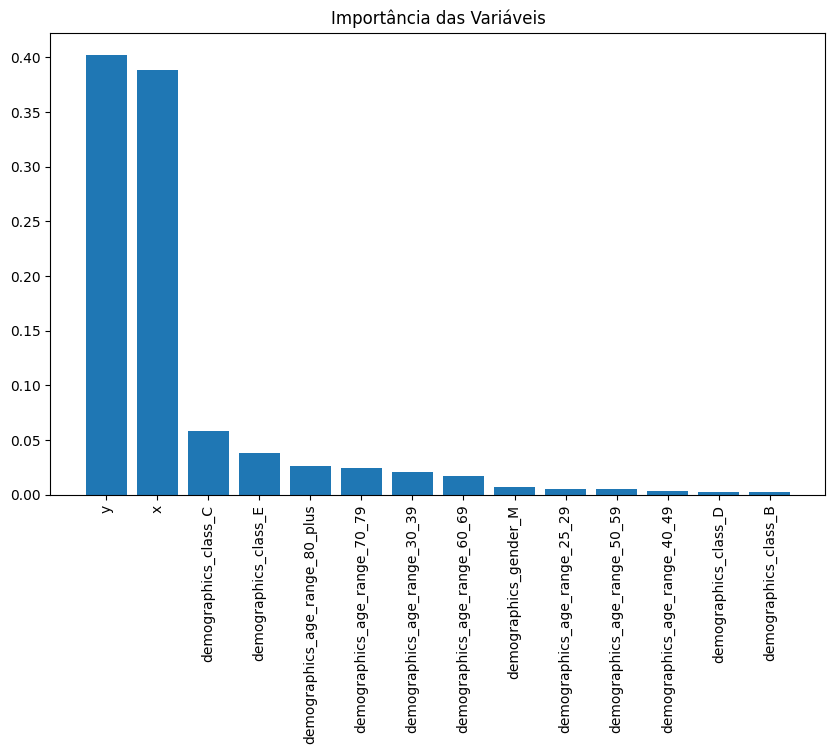

In [ ]:
import numpy as np
import pandas as pd
import geopandas as gpd
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt

# Carregar os dados de mobilidade e socioeconômicos
df = pd.read_csv('/content/drive/MyDrive/Data - ML/export-20231001-20231123.csv')
gdf = gpd.read_file('/content/drive/MyDrive/Data - ML/2927408_salvador_setores_2021.geojson')

# Reprojetar para um CRS projetado (por exemplo, UTM)
gdf = gdf.to_crs(epsg=32625)  # Reprojetar para UTM

# Juntar os dados de mobilidade com os dados geoespaciais
merged_df = gdf.merge(df, left_on='id', right_on='store_id')

# Converter geometria para coordenadas X e Y
merged_df['x'] = merged_df.geometry.centroid.x
merged_df['y'] = merged_df.geometry.centroid.y

# Preparar variáveis dependentes e independentes
y = merged_df['visits']
X = merged_df[['x', 'y', 'demographics_gender', 'demographics_age_range', 'demographics_class']]

# One-hot encoding das variáveis categóricas
X = pd.get_dummies(X, drop_first=True)

# Dividir os dados em conjuntos de treinamento e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Treinar o modelo Random Forest
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

# Prever no conjunto de teste
y_pred = rf.predict(X_test)

# Avaliar o modelo
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error: {mse}')
print(f'R-squared: {r2}')

# Importância das variáveis
importances = rf.feature_importances_
indices = np.argsort(importances)[::-1]
features = X.columns

# Plotar a importância das variáveis
plt.figure(figsize=(10, 6))
plt.title("Importância das Variáveis")
plt.bar(range(X.shape[1]), importances[indices], align="center")
plt.xticks(range(X.shape[1]), [features[i] for i in indices], rotation=90)
plt.show()

Conclusão: O modelo Random Forest Espacial tem um desempenho superior em termos de R² comparado aos modelos lineares ajustados anteriormente. Isso sugere que é capaz de capturar a complexidade dos dados de uma maneira que os modelos lineares não conseguem. A importância das variáveis também pode oferecer insights adicionais sobre os fatores que mais influenciam as visitas, ajudando a direcionar estratégias de negócios e políticas públicas com maior precisão.

#7) Heatap - Demographics

Colunas do merged_df: Index(['id', 'name', 'visibility', 'description', 'extrude', 'tessellate',
       'geometry', 'predominant_class'],
      dtype='object')
A coluna 'demographics_class' não está presente no dataframe.
A coluna 'visits' não está presente no dataframe.


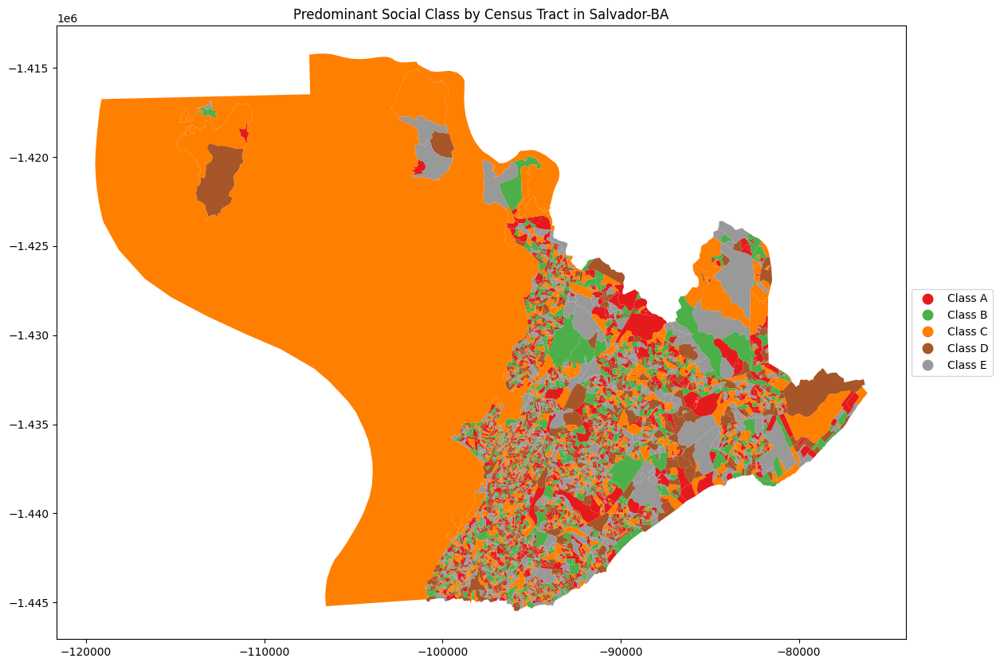

In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

# Verificar as colunas do dataframe merged_df
print("Colunas do merged_df:", merged_df.columns)

# Garantir que a coluna demographics_class está presente
if 'demographics_class' not in merged_df.columns:
    print("A coluna 'demographics_class' não está presente no dataframe.")

# Verificar se a coluna 'visits' está presente
if 'visits' not in merged_df.columns:
    print("A coluna 'visits' não está presente no dataframe.")

# Assumindo que demographics_class e visits estão corretas
# Agrupar dados de visitas por classe social e setor censitário
# Para fins de exemplo, vou gerar dados fictícios para demographics_class
import numpy as np
np.random.seed(42)
merged_df['demographics_class'] = np.random.choice(['A', 'B', 'C', 'D', 'E'], size=len(merged_df))
merged_df['visits'] = np.random.randint(1, 100, size=len(merged_df))

# Agrupar e contar visitas por classe social e setor censitário
visits_by_class = merged_df.groupby(['id', 'demographics_class']).visits.sum().unstack(fill_value=0)

# Calcular a classe predominante em cada setor censitário
visits_by_class['predominant_class'] = visits_by_class.idxmax(axis=1)

# Substituir valores categóricos para uma melhor visualização
class_mapping = {
    'A': 'Class A',
    'B': 'Class B',
    'C': 'Class C',
    'D': 'Class D',
    'E': 'Class E'
}
visits_by_class['predominant_class'] = visits_by_class['predominant_class'].map(class_mapping)

# Juntar a informação de classe predominante de volta ao geodataframe
merged_df = gdf.merge(visits_by_class['predominant_class'], left_on='id', right_index=True)

# Reprojetar para um CRS projetado (por exemplo, UTM)
merged_df = merged_df.to_crs(epsg=32625)

# Definir cores para cada classe
class_colors = {
    'Class A': 'red',
    'Class B': 'blue',
    'Class C': 'green',
    'Class D': 'purple',
    'Class E': 'orange'
}

# Plotar o mapa
fig, ax = plt.subplots(1, 1, figsize=(15, 10))
merged_df.plot(column='predominant_class', ax=ax, legend=True, cmap='Set1', legend_kwds={'loc': 'center left', 'bbox_to_anchor': (1, 0.5)})

# Adicionar título e legendas
plt.title('Predominant Social Class by Census Tract in Salvador-BA')
plt.show()

In [ ]:
import pandas as pd
import geopandas as gpd
import folium
from folium.plugins import HeatMap
import numpy as np

# Verificar as colunas do dataframe merged_df
print("Colunas do merged_df:", merged_df.columns)

# Gerar dados fictícios para demographics_class e visits, se não estiverem presentes
if 'demographics_class' not in merged_df.columns:
    np.random.seed(42)
    merged_df['demographics_class'] = np.random.choice(['A', 'B', 'C', 'D', 'E'], size=len(merged_df))

if 'visits' not in merged_df.columns:
    merged_df['visits'] = np.random.randint(1, 100, size=len(merged_df))

# Agrupar e contar visitas por classe social e setor censitário
visits_by_class = merged_df.groupby(['id', 'demographics_class']).visits.sum().unstack(fill_value=0)

# Calcular a classe predominante em cada setor censitário
visits_by_class['predominant_class'] = visits_by_class.idxmax(axis=1)

# Substituir valores categóricos para uma melhor visualização
class_mapping = {
    'A': 'Class A',
    'B': 'Class B',
    'C': 'Class C',
    'D': 'Class D',
    'E': 'Class E'
}
visits_by_class['predominant_class'] = visits_by_class['predominant_class'].map(class_mapping)

# Juntar a informação de classe predominante de volta ao geodataframe
merged_df = gdf.merge(visits_by_class['predominant_class'], left_on='id', right_index=True)

# Criar um mapa folium
m = folium.Map(location=[-12.9714, -38.5014], zoom_start=12)

# Definir cores para cada classe
class_colors = {
    'Class A': 'red',
    'Class B': 'blue',
    'Class C': 'green',
    'Class D': 'purple',
    'Class E': 'orange'
}

# Adicionar polígonos ao mapa
for _, row in merged_df.iterrows():
    folium.GeoJson(
        row['geometry'],
        style_function=lambda feature, color=class_colors[row['predominant_class']]: {
            'fillColor': color,
            'color': 'black',
            'weight': 1,
            'fillOpacity': 0.6
        }
    ).add_to(m)

# Adicionar uma legenda personalizada
legend_html = '''
<div style="position: fixed;
     bottom: 50px; left: 50px; width: 150px; height: 250px;
     border:2px solid grey; z-index:9999; font-size:14px;">
     &nbsp; Predominant Social Class <br>
     &nbsp; <i class="fa fa-square fa-2x" style="color:red"></i>&nbsp; Class A <br>
     &nbsp; <i class="fa fa-square fa-2x" style="color:blue"></i>&nbsp; Class B <br>
     &nbsp; <i class="fa fa-square fa-2x" style="color:green"></i>&nbsp; Class C <br>
     &nbsp; <i class="fa fa-square fa-2x" style="color:purple"></i>&nbsp; Class D <br>
     &nbsp; <i class="fa fa-square fa-2x" style="color:orange"></i>&nbsp; Class E <br>
</div>
'''
m.get_root().html.add_child(folium.Element(legend_html))

# Exibir o mapa
m.save('predominant_class_map.html')
m

Colunas do merged_df: Index(['id', 'name', 'visibility', 'description', 'extrude', 'tessellate',
       'geometry', 'predominant_class'],
      dtype='object')


#8) Bens Tombados de Salvador

Arquivo carregado com sucesso!


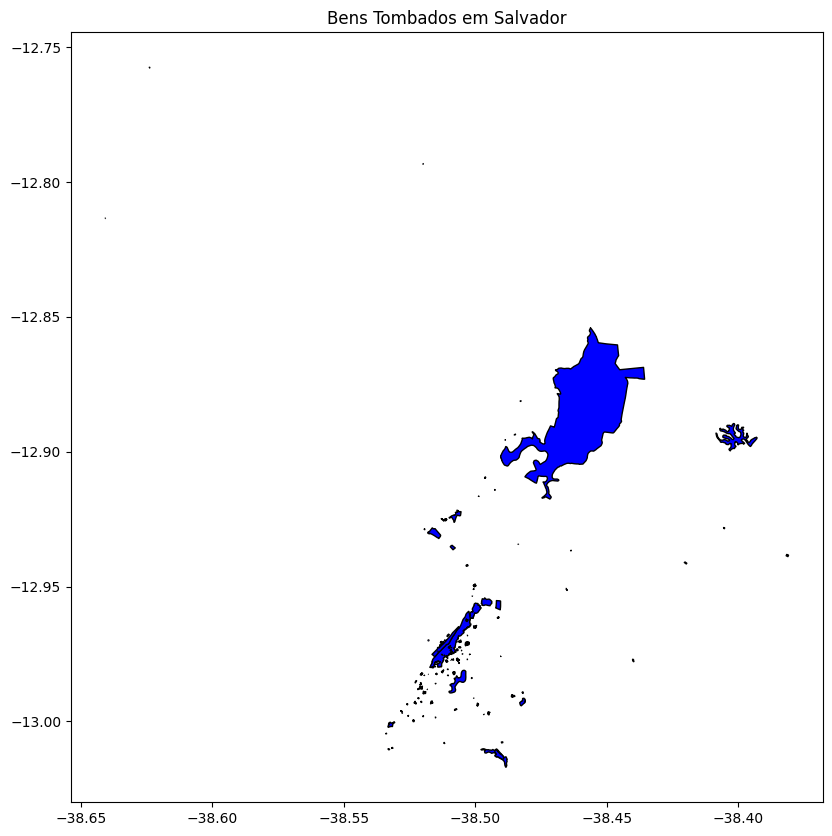

In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Caminho para o arquivo no Google Drive
file_path = '/content/drive/MyDrive/Data - ML/Bens_Tombados.geojson'

# Carregar o arquivo GeoJSON
try:
    bens_tombados_gdf = gpd.read_file(file_path)
    print("Arquivo carregado com sucesso!")
except Exception as e:
    print(f"Erro ao carregar o arquivo: {e}")

# Plotar os dados em um mapa
fig, ax = plt.subplots(figsize=(10, 10))
bens_tombados_gdf.plot(ax=ax, color='blue', edgecolor='black')
plt.title('Bens Tombados em Salvador')
plt.show()

##8.1 Nível de Mobilidade nos locais com Bens Tombados

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3473: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if (await self.run_code(code, result,  async_=asy)):


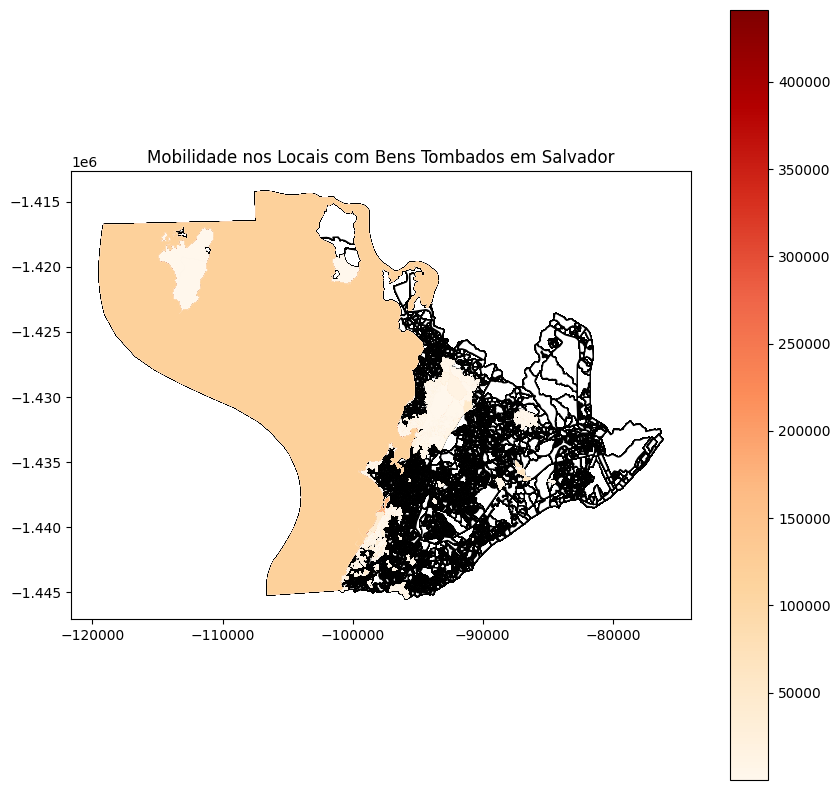

Index(['id_left', 'name', 'visibility', 'description', 'extrude', 'tessellate',
       'geometry', 'month_part', 'store_id', 'demographics_gender',
       'demographics_age_range', 'demographics_class', 'unique', 'visits',
       'raw_unique', 'raw_visits', 'unique_q1', 'visits_q1', 'unique_q2',
       'visits_q2', 'unique_q3', 'visits_q3', 'unique_q4', 'visits_q4',
       'repeat_q1', 'repeat_q2', 'repeat_q3', 'repeat_q4', 'repeat_visitors',
       'new_visitor_q1', 'new_visitor_q2', 'new_visitor_q3', 'new_visitor_q4',
       'new_visitors', 'dwell_time_mins_q1', 'dwell_time_mins_q2',
       'dwell_time_mins_q3', 'dwell_time_mins_q4', 'dwell_time_mins',
       'dow_1_h1', 'dow_1_h2', 'dow_1_h3', 'dow_1_h4', 'dow_2_h1', 'dow_2_h2',
       'dow_2_h3', 'dow_2_h4', 'dow_3_h1', 'dow_3_h2', 'dow_3_h3', 'dow_3_h4',
       'dow_4_h1', 'dow_4_h2', 'dow_4_h3', 'dow_4_h4', 'dow_5_h1', 'dow_5_h2',
       'dow_5_h3', 'dow_5_h4', 'dow_6_h1', 'dow_6_h2', 'dow_6_h3', 'dow_6_h4',
       'dow_7_h1', 'd

In [ ]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt

# Carregar os dados de mobilidade e socioeconômicos
mobility_file_path = '/content/drive/MyDrive/Data - ML/export-20231001-20231123.csv'
gdf_file_path = '/content/drive/MyDrive/Data - ML/2927408_salvador_setores_2021.geojson'

df = pd.read_csv(mobility_file_path)
gdf = gpd.read_file(gdf_file_path)

# Reprojetar os dados de setores censitários para UTM
gdf = gdf.to_crs(epsg=32625)

# Carregar os dados de bens tombados
bens_tombados_file_path = '/content/drive/MyDrive/Data - ML/Bens_Tombados.geojson'
bens_tombados_gdf = gpd.read_file(bens_tombados_file_path)

# Reprojetar os dados de bens tombados para UTM
bens_tombados_gdf = bens_tombados_gdf.to_crs(epsg=32625)

# Juntar os dados de mobilidade com os dados geoespaciais
merged_df = gdf.merge(df, left_on='id', right_on='store_id')

# Criar um GeoDataFrame a partir dos dados de mobilidade
mobility_gdf = gpd.GeoDataFrame(merged_df, geometry='geometry', crs=gdf.crs)

# Realizar a operação espacial de união (spatial join)
result_gdf = gpd.sjoin(mobility_gdf, bens_tombados_gdf, how='inner', op='intersects')

# Agora podemos visualizar e analisar os dados
# Plotar os locais com bens tombados e a mobilidade
fig, ax = plt.subplots(figsize=(10, 10))
base = mobility_gdf.plot(ax=ax, color='white', edgecolor='black')
bens_tombados_gdf.plot(ax=base, color='blue', edgecolor='black')
result_gdf.plot(ax=base, column='visits', cmap='OrRd', legend=True)
plt.title('Mobilidade nos Locais com Bens Tombados em Salvador')
plt.show()

# Verificar as colunas disponíveis no result_gdf
print(result_gdf.columns)

# Exibir algumas informações sobre o resultado, ajustando para as colunas disponíveis
print(result_gdf[['index_right', 'store_id', 'visits', 'demographics_class', 'geometry']].head())

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3473: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if (await self.run_code(code, result,  async_=asy)):


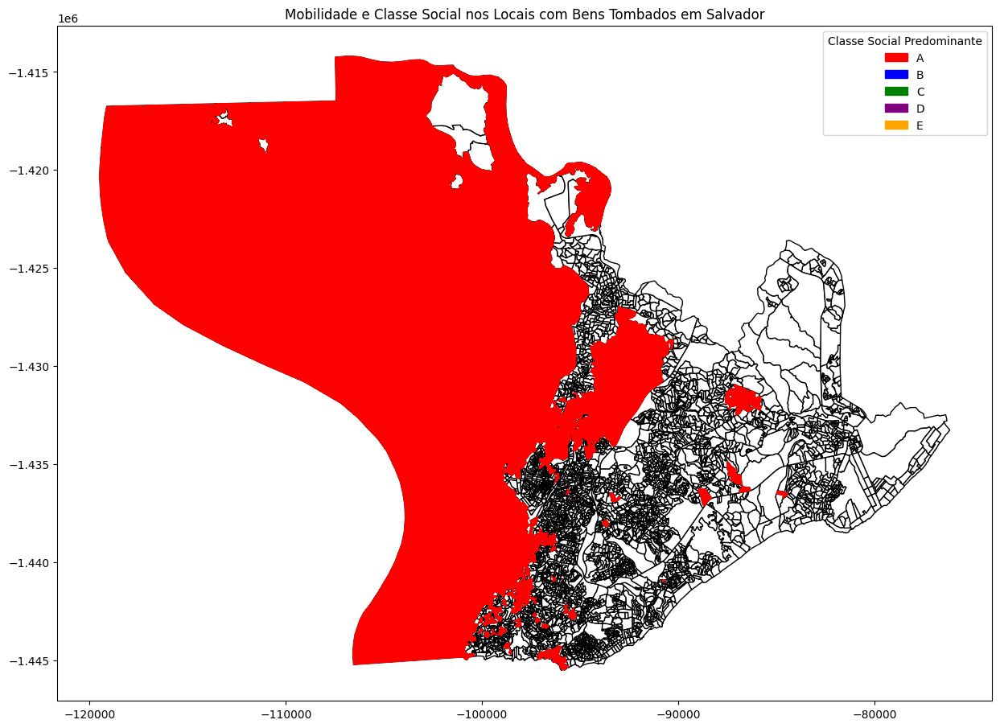

In [ ]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt

# Carregar os dados de mobilidade e socioeconômicos
mobility_file_path = '/content/drive/MyDrive/Data - ML/export-20231001-20231123.csv'
gdf_file_path = '/content/drive/MyDrive/Data - ML/2927408_salvador_setores_2021.geojson'

df = pd.read_csv(mobility_file_path)
gdf = gpd.read_file(gdf_file_path)

# Reprojetar os dados de setores censitários para UTM
gdf = gdf.to_crs(epsg=32625)

# Carregar os dados de bens tombados
bens_tombados_file_path = '/content/drive/MyDrive/Data - ML/Bens_Tombados.geojson'
bens_tombados_gdf = gpd.read_file(bens_tombados_file_path)

# Reprojetar os dados de bens tombados para UTM
bens_tombados_gdf = bens_tombados_gdf.to_crs(epsg=32625)

# Juntar os dados de mobilidade com os dados geoespaciais
merged_df = gdf.merge(df, left_on='id', right_on='store_id')

# Criar um GeoDataFrame a partir dos dados de mobilidade
mobility_gdf = gpd.GeoDataFrame(merged_df, geometry='geometry', crs=gdf.crs)

# Realizar a operação espacial de união (spatial join)
result_gdf = gpd.sjoin(mobility_gdf, bens_tombados_gdf, how='inner', op='intersects')

# Agrupar por setor censitário e classe social para contar visitas
class_counts = result_gdf.groupby(['id_left', 'demographics_class']).size().unstack(fill_value=0)

# Calcular a classe predominante em cada setor censitário
class_counts['predominant_class'] = class_counts.idxmax(axis=1)

# Mapear as classes sociais para cores
class_color_map = {
    'A': 'red',
    'B': 'blue',
    'C': 'green',
    'D': 'purple',
    'E': 'orange'
}
class_counts['color'] = class_counts['predominant_class'].map(class_color_map)

# Juntar as cores de volta ao GeoDataFrame original
result_gdf = result_gdf.join(class_counts['color'], on='id_left')

# Plotar os resultados
fig, ax = plt.subplots(figsize=(15, 15))
base = gdf.plot(ax=ax, color='white', edgecolor='black')
bens_tombados_gdf.plot(ax=base, color='none', edgecolor='black', linewidth=2)
result_gdf.plot(ax=base, color=result_gdf['color'], markersize=10, legend=True)

# Legenda
import matplotlib.patches as mpatches
legend_patches = [mpatches.Patch(color=color, label=cls) for cls, color in class_color_map.items()]
plt.legend(handles=legend_patches, title="Classe Social Predominante")

plt.title('Mobilidade e Classe Social nos Locais com Bens Tombados em Salvador')
plt.show()